In [ ]:
# ==============================================================================
# CELLA 1: SETUP, IMPORT E INSTALLAZIONE
# ==============================================================================

# Potrebbe essere necessario installare scikit-learn
# !pip install scikit-learn

import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
from pathlib import Path
from sklearn.cluster import DBSCAN

# Monta Google Drive
from google.colab import drive
drive.mount('/content/drive')

print("Setup completato. Scikit-learn e Google Drive sono pronti.")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Setup completato. Scikit-learn e Google Drive sono pronti.


In [ ]:
# ==============================================================================
# CELLA 2: FUNZIONE DI RILEVAMENTO "RILEVA, MASCHERA, RIPETI"
# ==============================================================================
import cv2
import numpy as np
from pathlib import Path

def find_instances_mask_and_repeat(model_img, scene_img, scene_name=""):
    """
    Approccio finale basato su un ciclo iterativo che maschera le istanze trovate.
    Progettato per trovare tutte le copie di un oggetto.
    """

    # --- Parametri Bilanciati ---
    min_match_count = 12
    ratio_thresh = 0.72

    # Adattamento per la rotazione in scene specifiche
    if scene_name == "scene_9.jpg":
        model_img = cv2.rotate(model_img, cv2.ROTATE_90_CLOCKWISE)

    sift = cv2.SIFT_create()
    model_gray = cv2.cvtColor(model_img, cv2.COLOR_BGR2GRAY)
    kp_model, des_model = sift.detectAndCompute(model_gray, None)

    if des_model is None or len(kp_model) < 2: return []

    matcher = cv2.BFMatcher()

    found_instances = []
    current_scene_img = scene_img.copy()

    # Ciclo con valvola di sicurezza (massimo 10 istanze dello stesso libro)
    for _ in range(10):
        scene_gray = cv2.cvtColor(current_scene_img, cv2.COLOR_BGR2GRAY)
        kp_scene, des_scene = sift.detectAndCompute(scene_gray, None)

        if des_scene is None or len(kp_scene) < 2: break

        knn_matches = matcher.knnMatch(des_model, des_scene, k=2)

        good_matches = []
        if knn_matches:
            for m, n in knn_matches:
                if len((m,n)) == 2 and m.distance < ratio_thresh * n.distance:
                    good_matches.append(m)

        if len(good_matches) < min_match_count:
            break

        src_pts = np.float32([kp_model[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
        dst_pts = np.float32([kp_scene[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)
        M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

        if M is not None and np.sum(mask) >= min_match_count:
            h, w = model_img.shape[:2]
            model_corners = np.float32([[0, 0], [0, h], [w, h], [w, 0]]).reshape(-1, 1, 2)
            box = np.int32(cv2.perspectiveTransform(model_corners, M)).reshape(4, 2)

            # --- Filtri di Validazione per ogni Istanza Trovata ---
            is_valid = True

            # 1. Filtro Area
            if cv2.contourArea(box) < 2000:
                is_valid = False

            # 2. Filtro Forma Convessa
            if not cv2.isContourConvex(box):
                is_valid = False

            # 3. Filtro di Verticalità (meno restrittivo)
            if scene_name != "scene_9.jpg": # Non applicare questo filtro ai libri ruotati
                v_diff_left = abs(box[0][0] - box[1][0])
                v_diff_right = abs(box[3][0] - box[2][0])
                # Tolleriamo un'inclinazione fino a 50 pixel per gestire la prospettiva
                if v_diff_left > 50 or v_diff_right > 50:
                    is_valid = False

            if is_valid:
                found_instances.append(box)
                # Maschera l'istanza trovata per la prossima iterazione
                cv2.fillPoly(current_scene_img, [box], (0, 0, 0))
            else:
                # Se l'istanza non è valida, usciamo dal ciclo per questo modello
                # per evitare di trovare ripetutamente lo stesso match errato.
                break
        else:
            # Se non troviamo più un'omografia valida, abbiamo finito.
            break

    return found_instances

print("Funzione 'find_instances_mask_and_repeat' definita.")

Funzione 'find_instances_mask_and_repeat' definita.


Caricati 22 modelli. Analisi di 29 scene in corso...

--- Analisi della scena: scene_0.jpg ---

  --- Risultato finale per la scena ---
  -> Nessuna istanza trovata.

--- Analisi della scena: scene_1.jpg ---

  --- Risultato finale per la scena ---
  ✓ Trovate 2 istanze finali di model_18


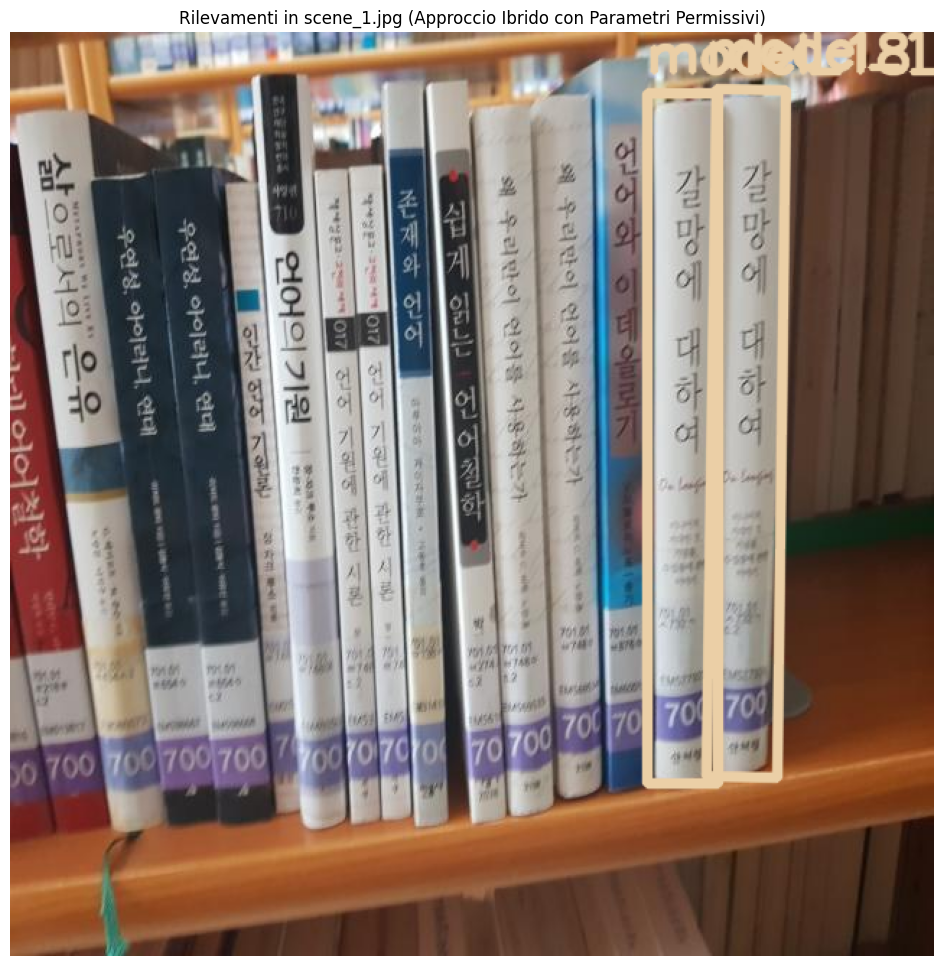


--- Analisi della scena: scene_10.jpg ---

  --- Risultato finale per la scena ---
  ✓ Trovate 1 istanze finali di model_19


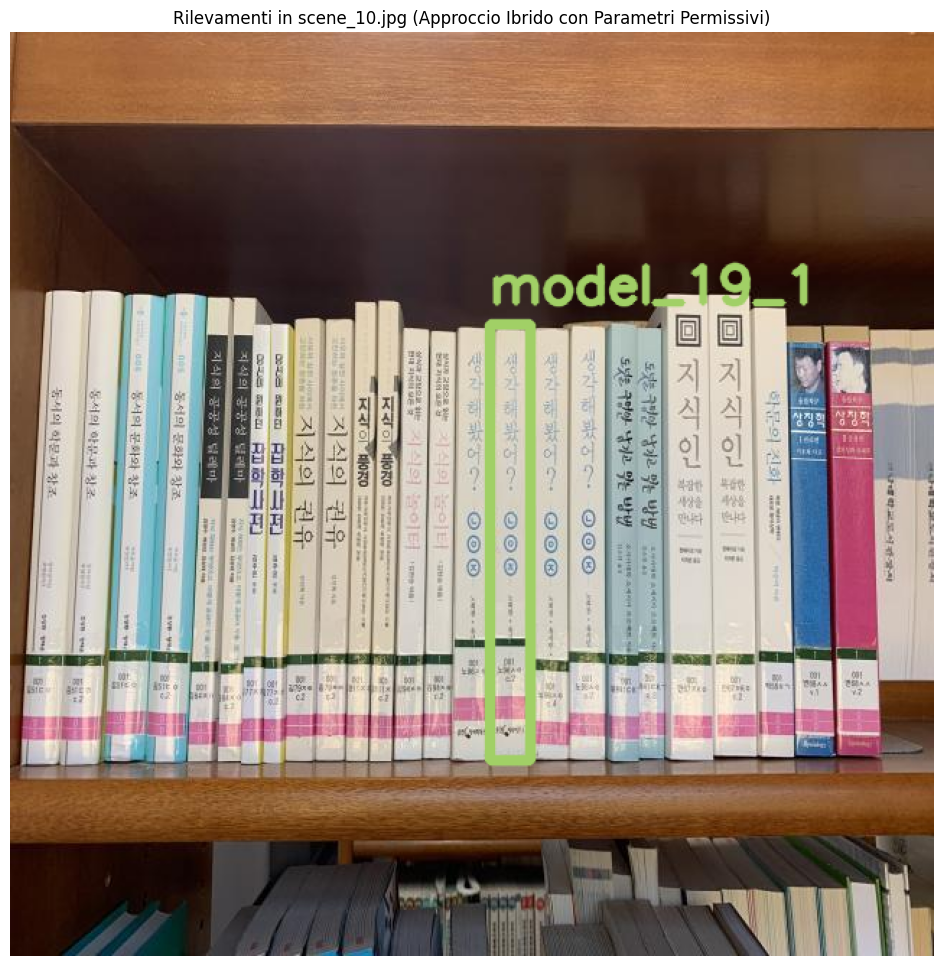


--- Analisi della scena: scene_11.jpg ---

  --- Risultato finale per la scena ---
  -> Nessuna istanza trovata.

--- Analisi della scena: scene_12.jpg ---

  --- Risultato finale per la scena ---
  -> Nessuna istanza trovata.

--- Analisi della scena: scene_13.jpg ---

  --- Risultato finale per la scena ---
  -> Nessuna istanza trovata.

--- Analisi della scena: scene_14.jpg ---

  --- Risultato finale per la scena ---
  -> Nessuna istanza trovata.

--- Analisi della scena: scene_15.jpg ---

  --- Risultato finale per la scena ---
  ✓ Trovate 1 istanze finali di model_11
  ✓ Trovate 1 istanze finali di model_12


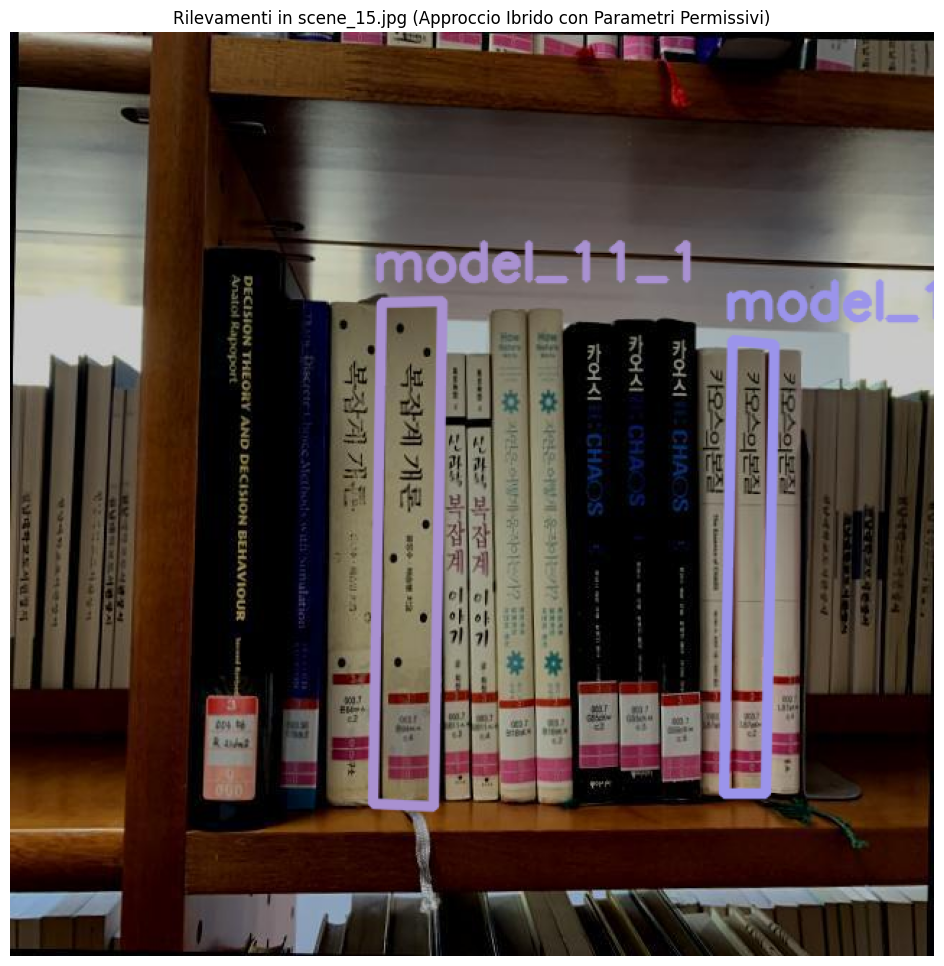


--- Analisi della scena: scene_16.jpg ---

  --- Risultato finale per la scena ---
  ✓ Trovate 1 istanze finali di model_11
  ✓ Trovate 1 istanze finali di model_12


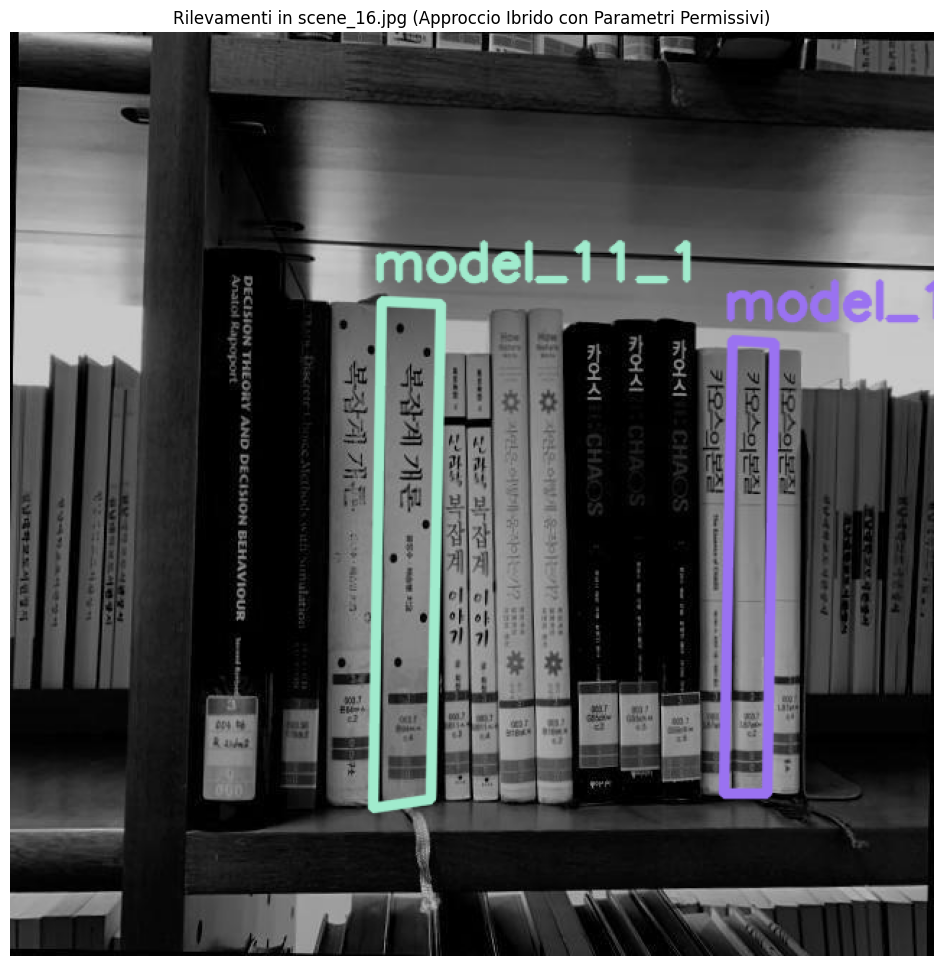


--- Analisi della scena: scene_17.jpg ---

  --- Risultato finale per la scena ---
  ✓ Trovate 1 istanze finali di model_11
  ✓ Trovate 1 istanze finali di model_12


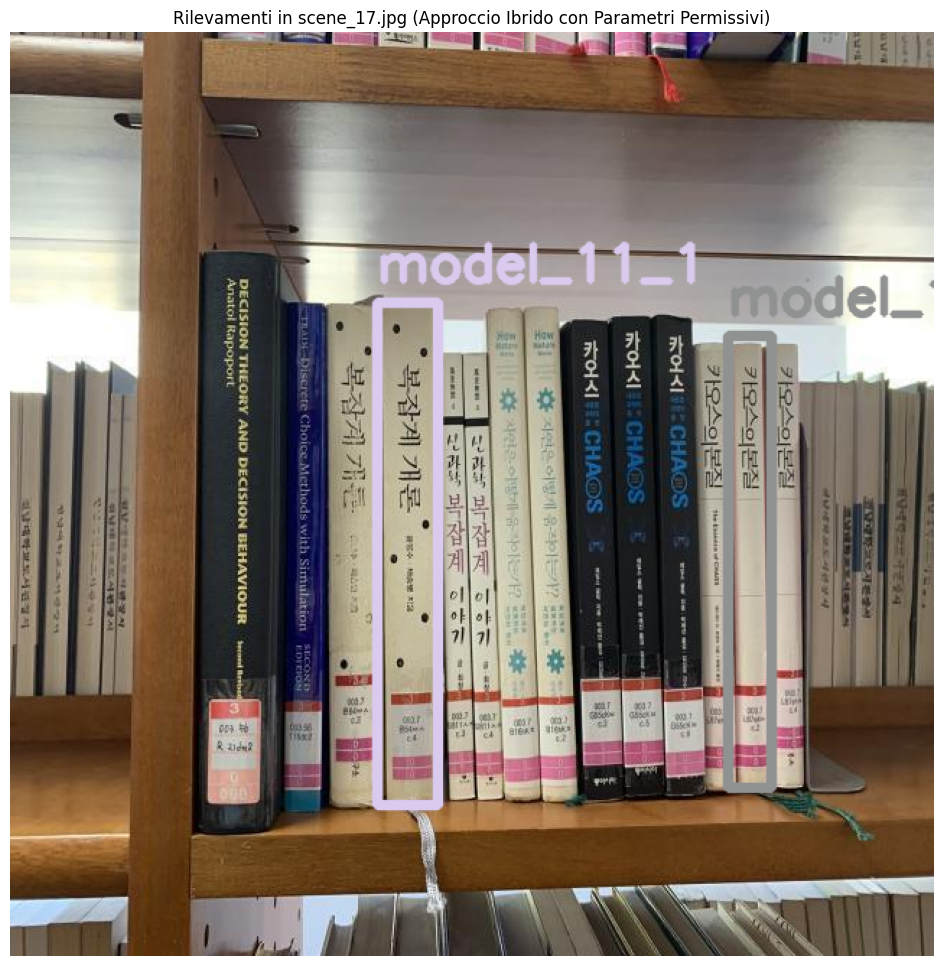


--- Analisi della scena: scene_18.jpg ---

  --- Risultato finale per la scena ---
  ✓ Trovate 3 istanze finali di model_8
  ✓ Trovate 3 istanze finali di model_9
  ✓ Trovate 3 istanze finali di model_10


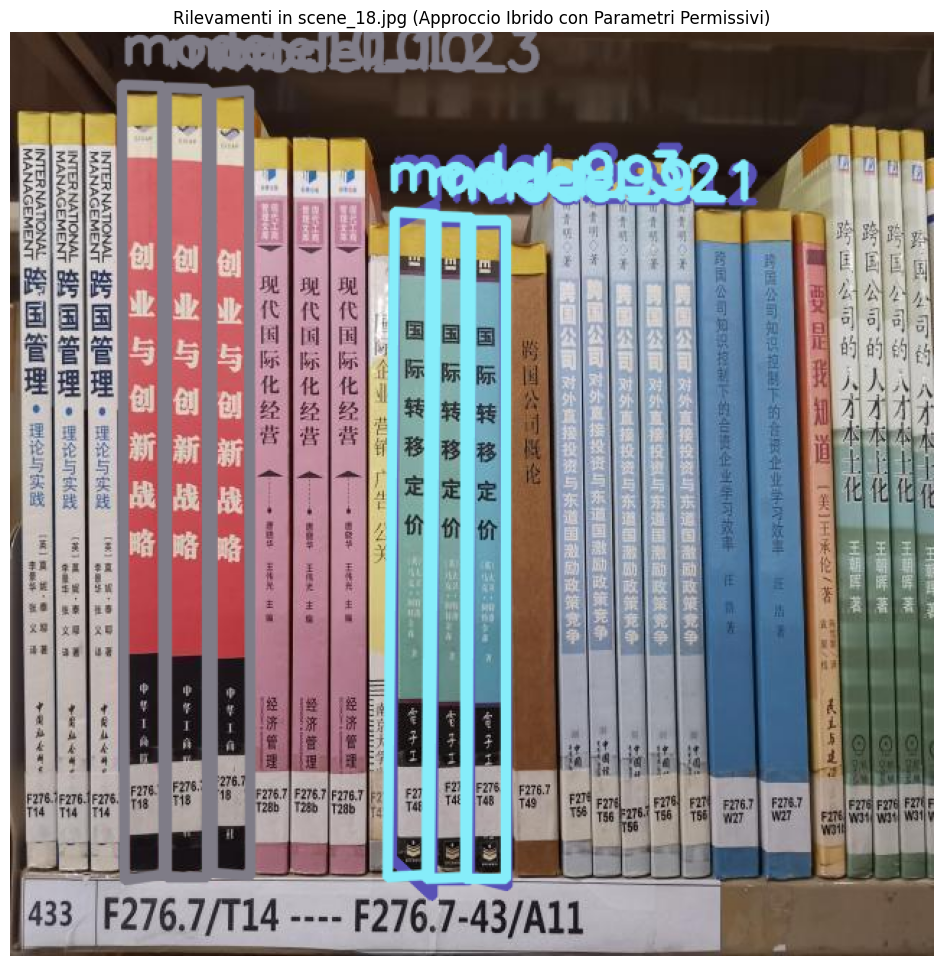


--- Analisi della scena: scene_19.jpg ---

  --- Risultato finale per la scena ---
  ✓ Trovate 1 istanze finali di model_6
  ✓ Trovate 2 istanze finali di model_7


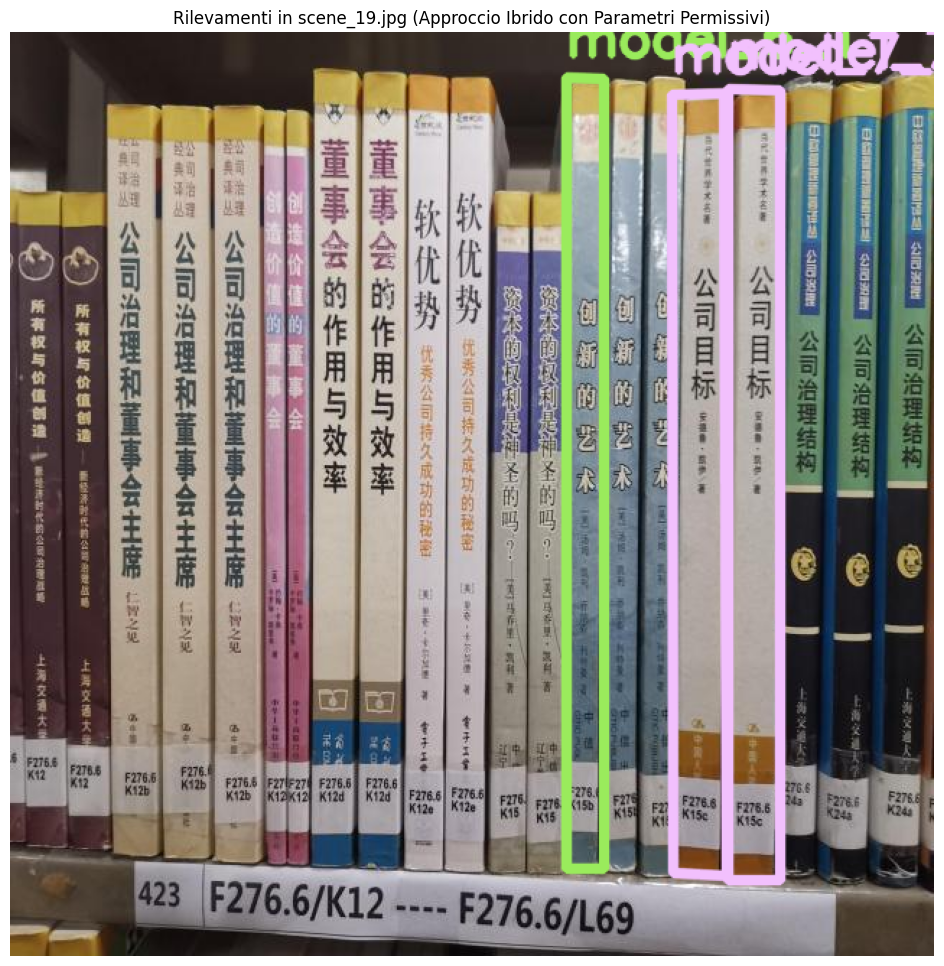


--- Analisi della scena: scene_2.jpg ---

  --- Risultato finale per la scena ---
  ✓ Trovate 1 istanze finali di model_17


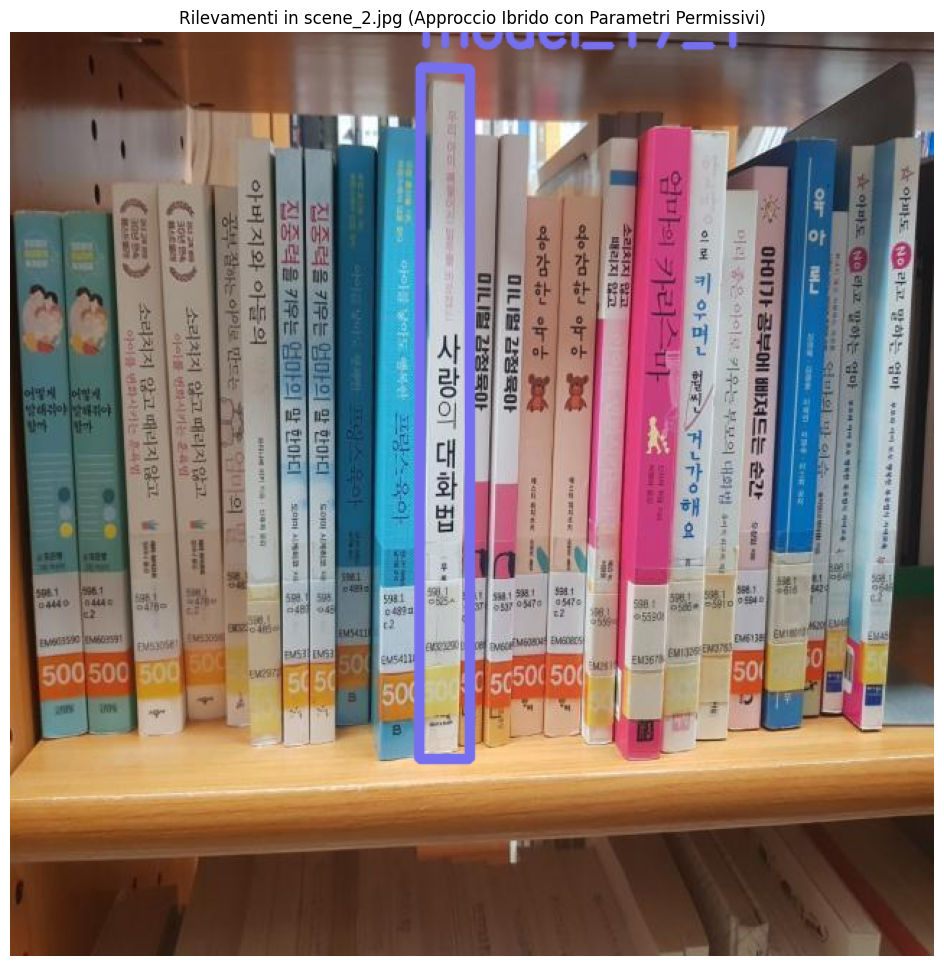


--- Analisi della scena: scene_20.jpg ---

  --- Risultato finale per la scena ---
  -> Nessuna istanza trovata.

--- Analisi della scena: scene_21.jpg ---

  --- Risultato finale per la scena ---
  -> Nessuna istanza trovata.

--- Analisi della scena: scene_22.jpg ---

  --- Risultato finale per la scena ---
  -> Nessuna istanza trovata.

--- Analisi della scena: scene_23.jpg ---

  --- Risultato finale per la scena ---
  ✓ Trovate 1 istanze finali di model_5


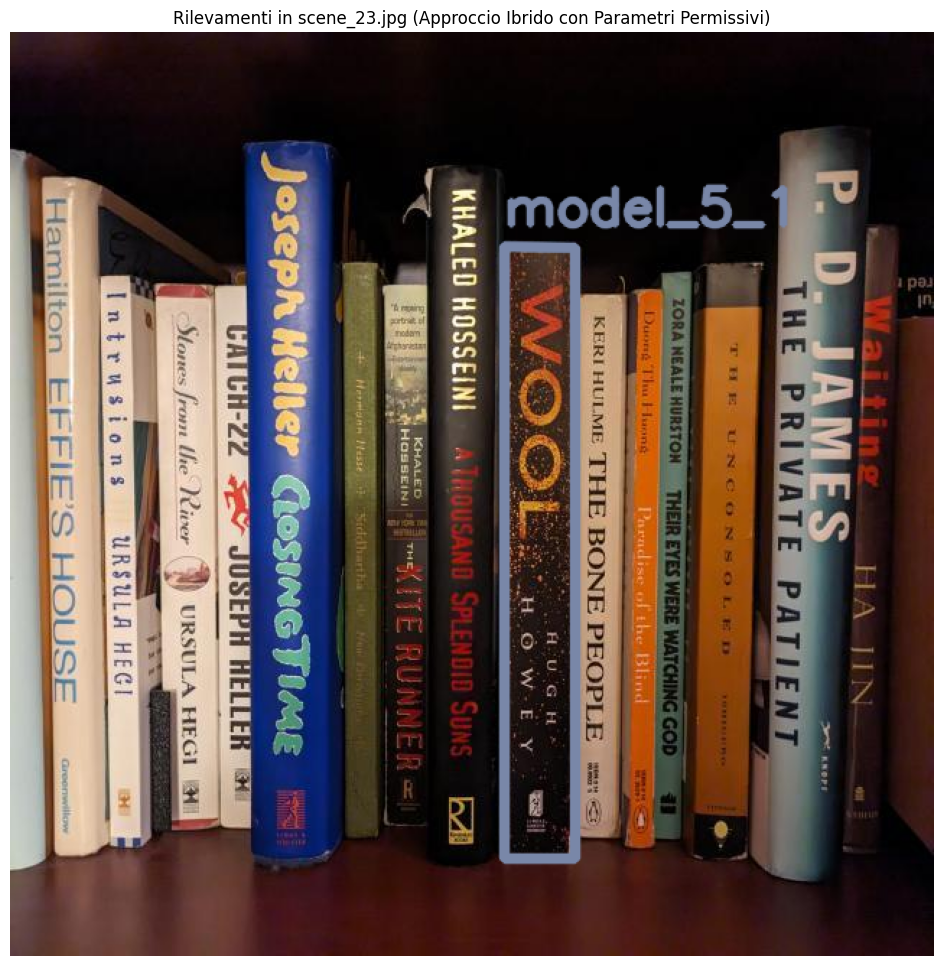


--- Analisi della scena: scene_24.jpg ---

  --- Risultato finale per la scena ---
  -> Nessuna istanza trovata.

--- Analisi della scena: scene_25.jpg ---

  --- Risultato finale per la scena ---
  -> Nessuna istanza trovata.

--- Analisi della scena: scene_26.jpg ---

  --- Risultato finale per la scena ---
  ✓ Trovate 2 istanze finali di model_0
  ✓ Trovate 1 istanze finali di model_4


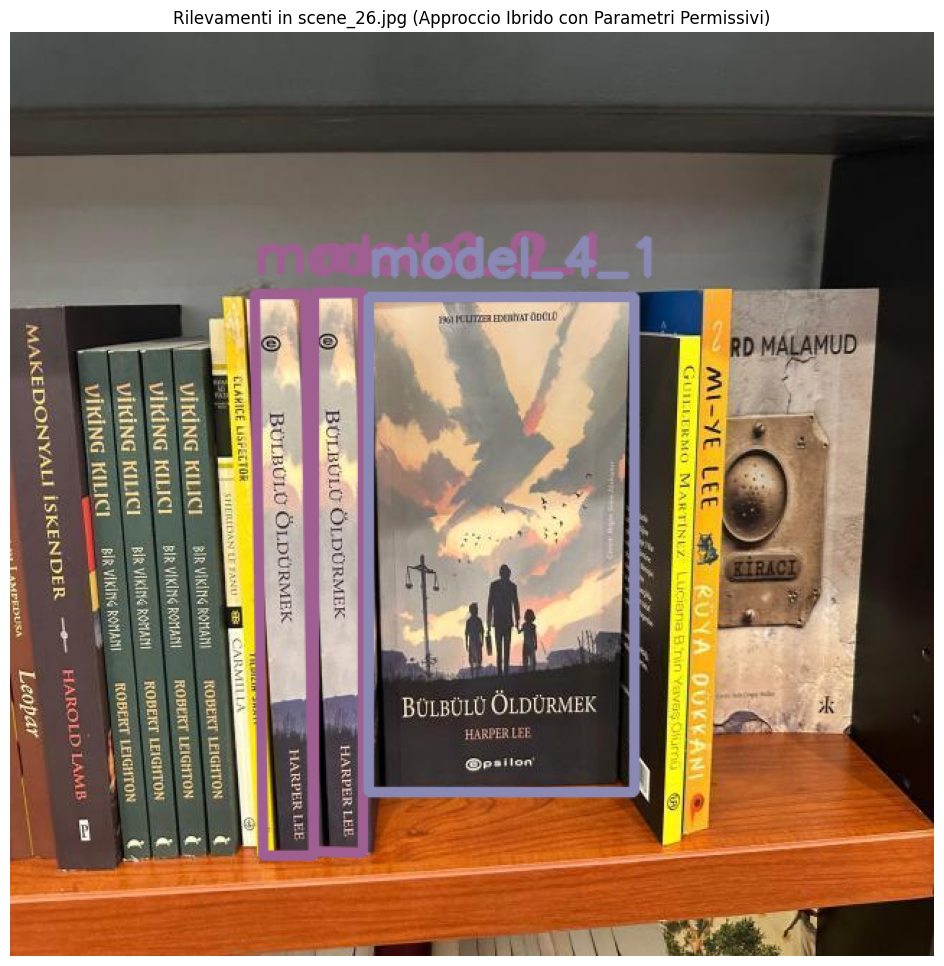


--- Analisi della scena: scene_27.jpg ---

  --- Risultato finale per la scena ---
  ✓ Trovate 3 istanze finali di model_2
  ✓ Trovate 1 istanze finali di model_3


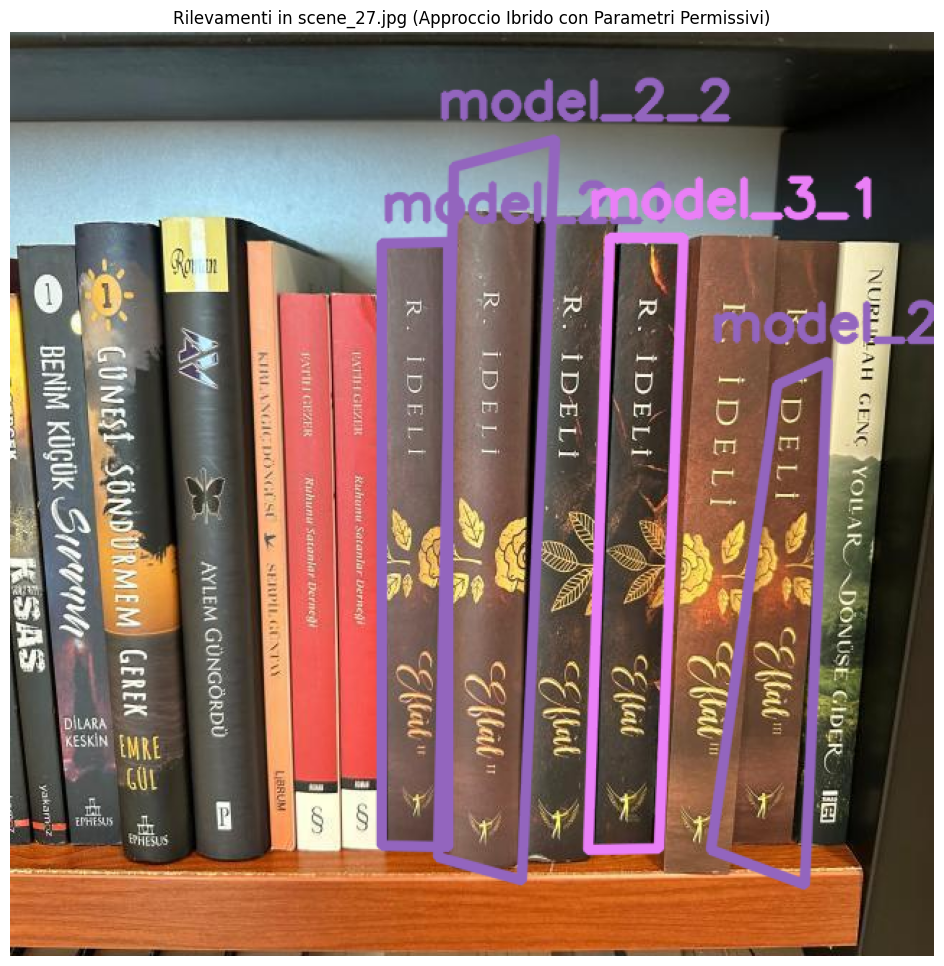


--- Analisi della scena: scene_28.jpg ---

  --- Risultato finale per la scena ---
  ✓ Trovate 2 istanze finali di model_1


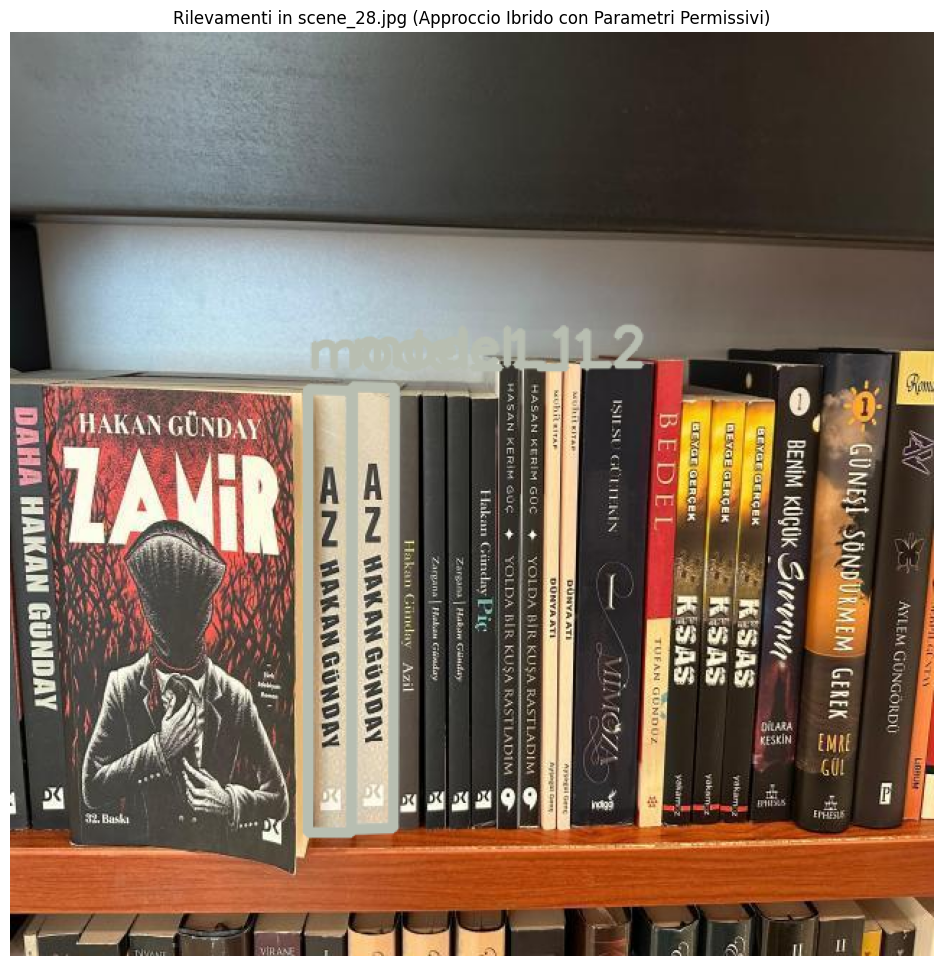


--- Analisi della scena: scene_3.jpg ---

  --- Risultato finale per la scena ---
  ✓ Trovate 2 istanze finali di model_16


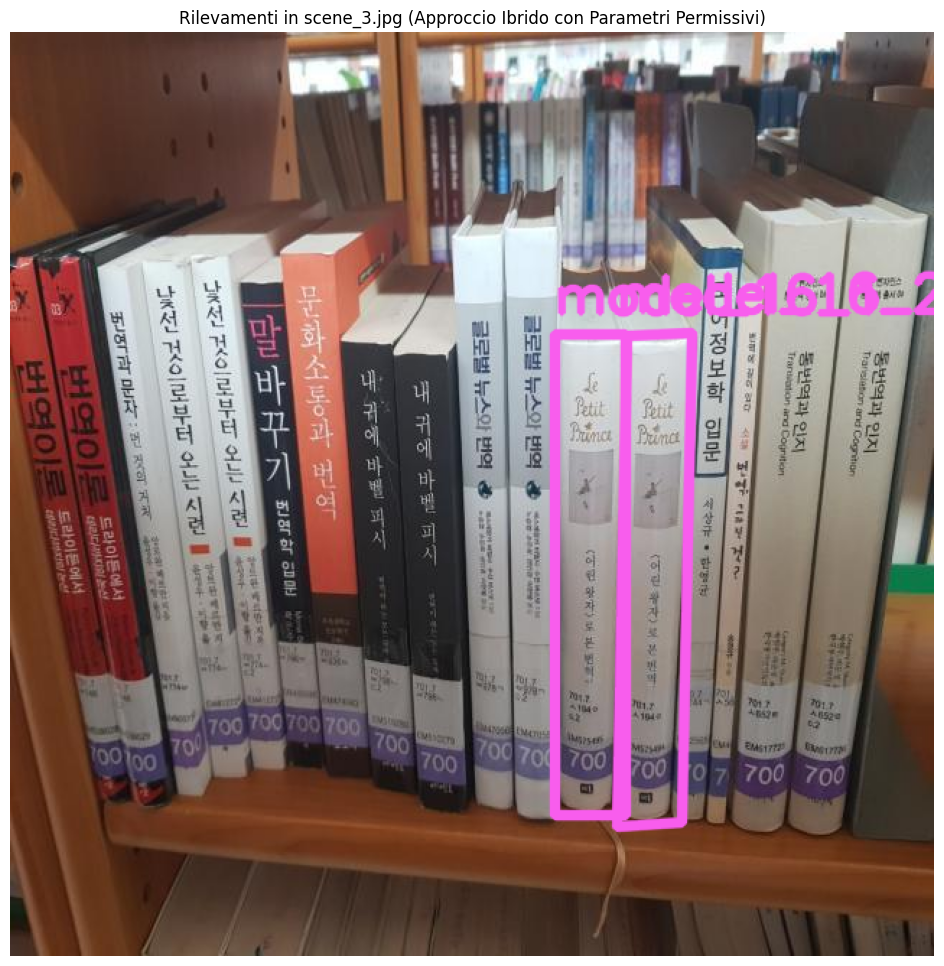


--- Analisi della scena: scene_4.jpg ---

  --- Risultato finale per la scena ---
  ✓ Trovate 2 istanze finali di model_14
  ✓ Trovate 2 istanze finali di model_15


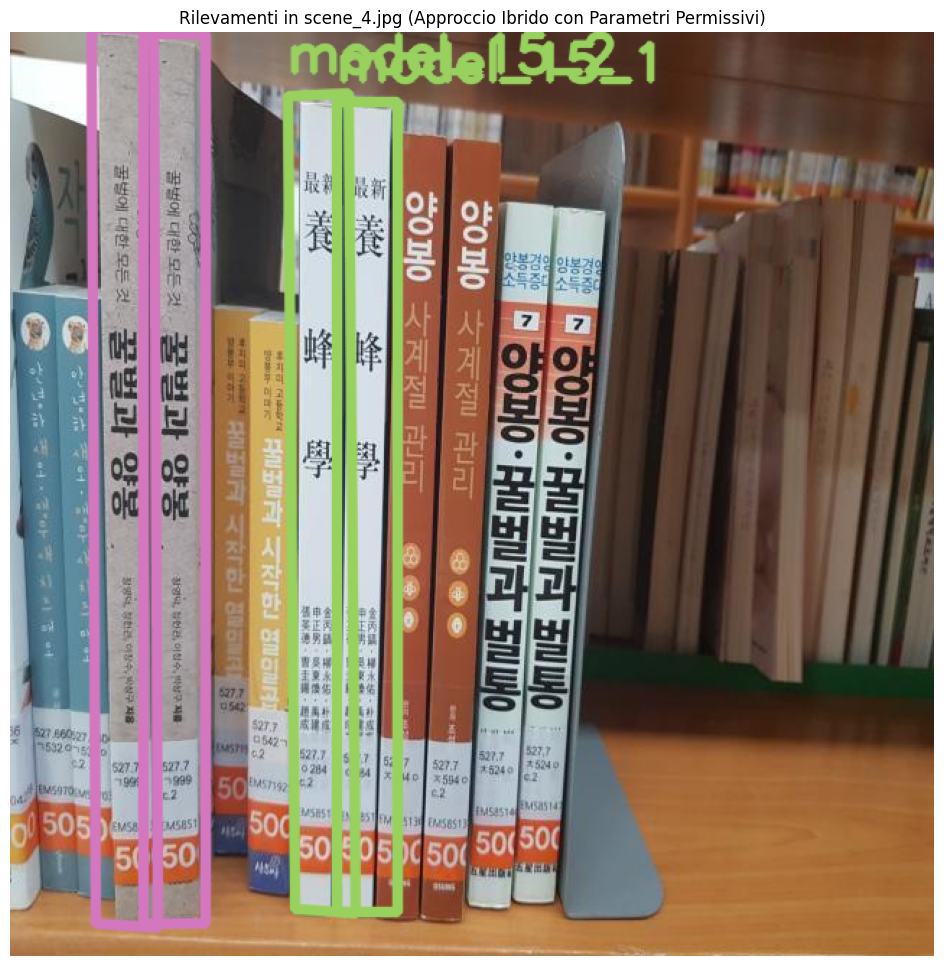


--- Analisi della scena: scene_5.jpg ---

  --- Risultato finale per la scena ---
  ✓ Trovate 1 istanze finali di model_13


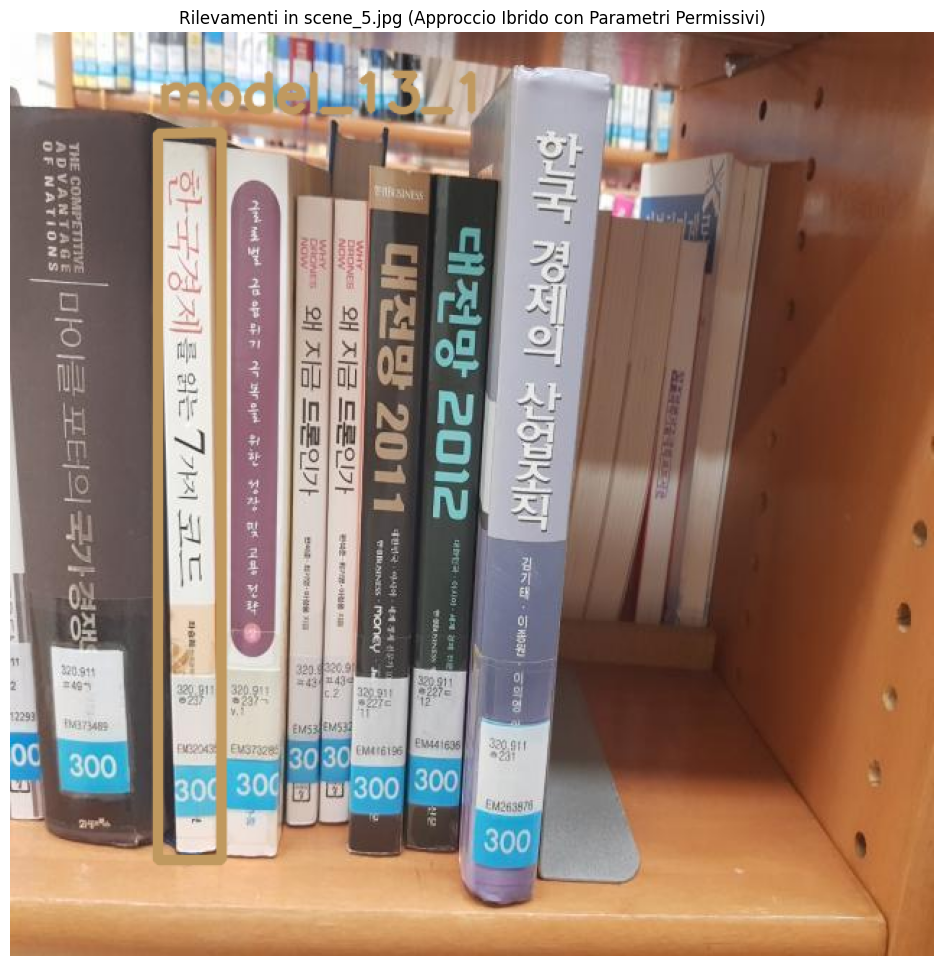


--- Analisi della scena: scene_6.jpg ---

  --- Risultato finale per la scena ---
  ✓ Trovate 1 istanze finali di model_21


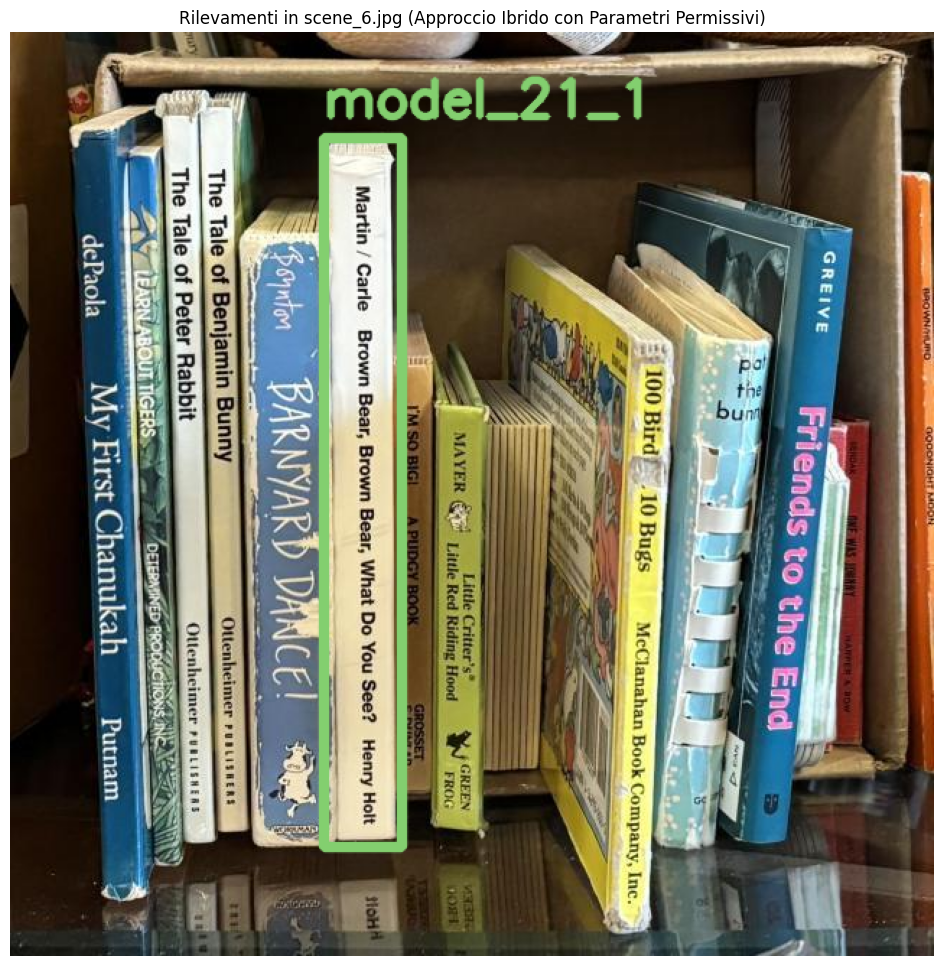


--- Analisi della scena: scene_7.jpg ---

  --- Risultato finale per la scena ---
  ✓ Trovate 2 istanze finali di model_20


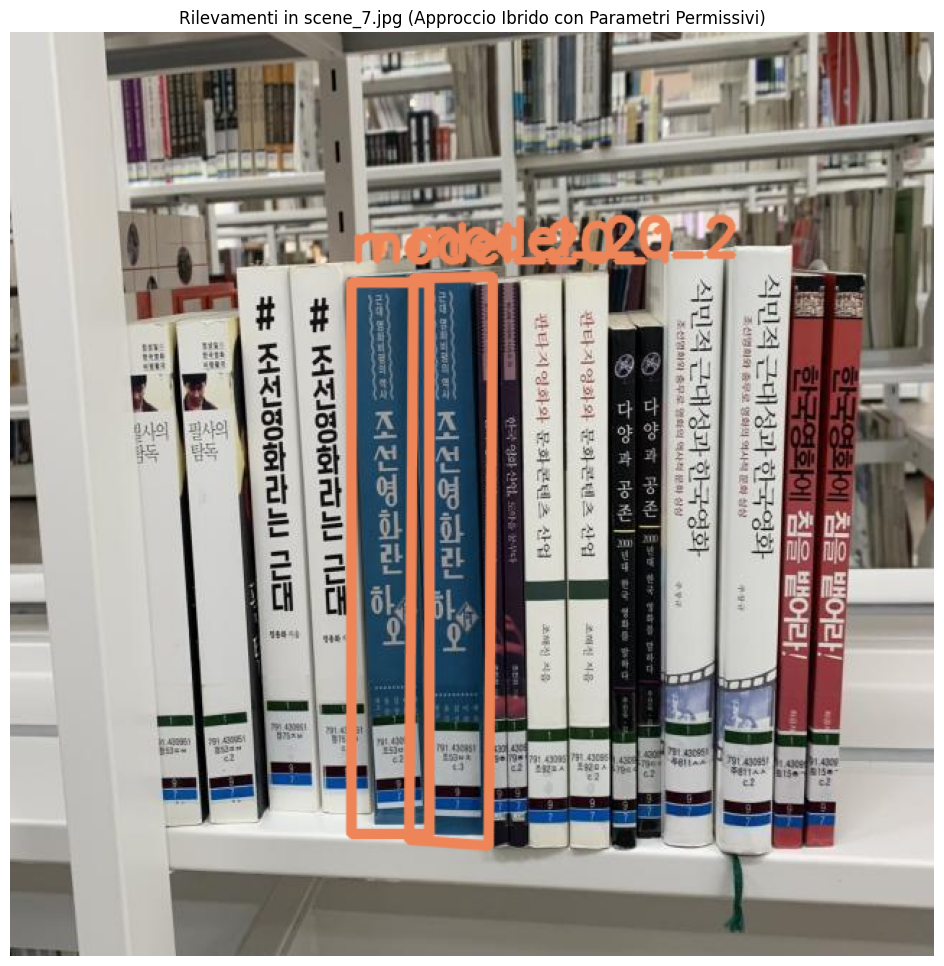


--- Analisi della scena: scene_8.jpg ---

  --- Risultato finale per la scena ---
  -> Nessuna istanza trovata.

--- Analisi della scena: scene_9.jpg ---

  --- Risultato finale per la scena ---
  ✓ Trovate 1 istanze finali di model_19


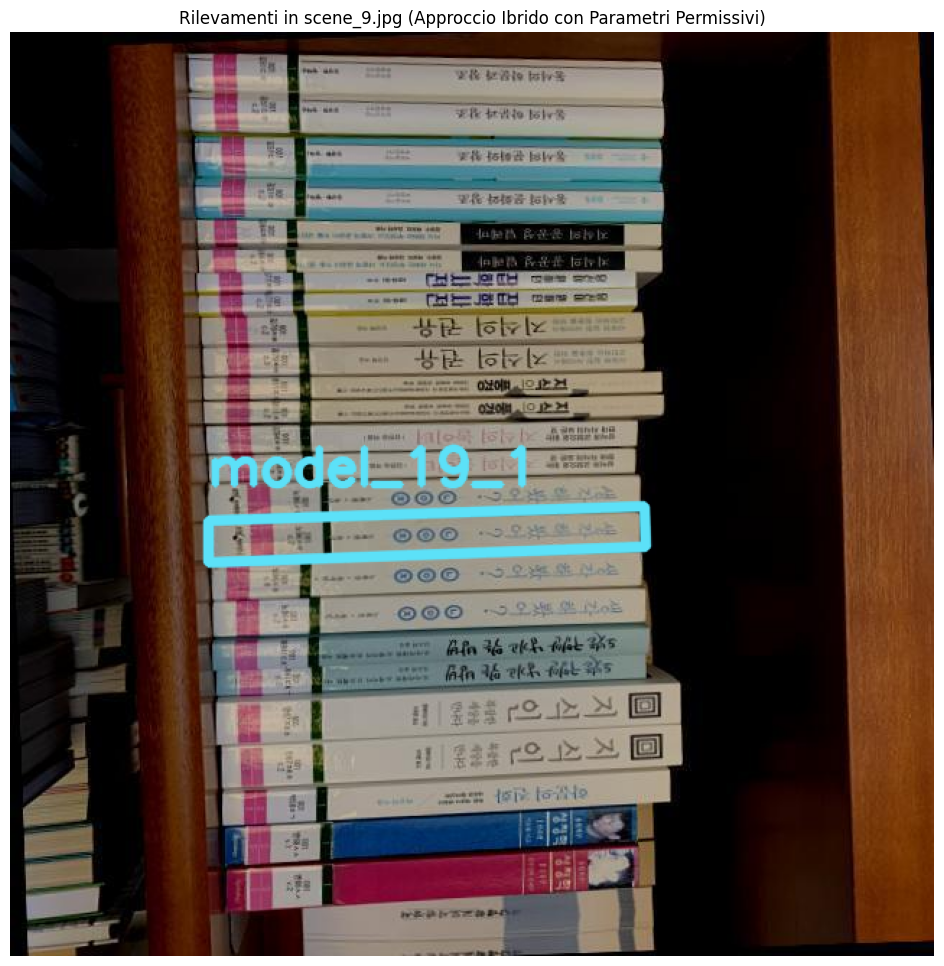


--- Analisi completata ---


In [ ]:
# ==============================================================================
# CELLA FINALE: APPROCCIO IBRIDO GENERALIZZATO (PARAMETRI PERMISSIVI)
# ==============================================================================
import cv2
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

# --- Funzione di Rilevamento Ausiliaria ---
# Trova UNA singola istanza in un'immagine con parametri più permissivi.
def find_single_best_instance(model_img, scene_img, min_match_count=10, ratio_thresh=0.75): # <-- PARAMETRI MODIFICATI
    sift = cv2.SIFT_create()
    model_gray = cv2.cvtColor(model_img, cv2.COLOR_BGR2GRAY)
    scene_gray = cv2.cvtColor(scene_img, cv2.COLOR_BGR2GRAY)

    kp_model, des_model = sift.detectAndCompute(model_gray, None)
    kp_scene, des_scene = sift.detectAndCompute(scene_gray, None)

    if des_model is None or des_scene is None or len(des_model) < 2: return None

    matcher = cv2.BFMatcher()
    knn_matches = matcher.knnMatch(des_model, des_scene, k=2)

    good_matches = []
    if knn_matches:
        for m, n in knn_matches:
            if len((m,n))==2 and m.distance < ratio_thresh * n.distance:
                good_matches.append(m)

    if len(good_matches) < min_match_count: return None

    src_pts = np.float32([kp_model[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    dst_pts = np.float32([kp_scene[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

    if M is not None and np.sum(mask) >= min_match_count:
        h, w = model_img.shape[:2]
        model_corners = np.float32([[0, 0], [0, h], [w, h], [w, 0]]).reshape(-1, 1, 2)
        box = np.int32(cv2.perspectiveTransform(model_corners, M)).reshape(4, 2)

        # Filtri di qualità di base
        if cv2.isContourConvex(box) and cv2.contourArea(box) > 2000:
             return {'box': box, 'score': np.sum(mask)}
    return None

# --- Funzione di supporto per NMS ---
def apply_nms(instances, iou_thresh=0.3):
    if not instances: return []
    instances.sort(key=lambda x: x['score'], reverse=True)
    cleaned_instances = []
    while instances:
        best = instances.pop(0)
        cleaned_instances.append(best)
        remaining = []
        for other in instances:
            # Calcolo IoU
            x1 = max(best['box'][:,0].min(), other['box'][:,0].min())
            y1 = max(best['box'][:,1].min(), other['box'][:,1].min())
            x2 = min(best['box'][:,0].max(), other['box'][:,0].max())
            y2 = min(best['box'][:,1].max(), other['box'][:,1].max())
            intersection = max(0, x2 - x1) * max(0, y2 - y1)
            union = cv2.contourArea(best['box']) + cv2.contourArea(other['box']) - intersection
            iou = intersection / union if union > 0 else 1.0
            if iou < iou_thresh:
                remaining.append(other)
        instances = remaining
    return cleaned_instances

# --- Funzione di supporto per il disegno ---
def draw_instances_on_scene(scene_image, instances_by_model):
    output_image = scene_image.copy()
    model_colors = {}
    for model_name, instances in instances_by_model.items():
        if model_name not in model_colors:
            model_colors[model_name] = tuple(np.random.randint(80, 256, 3).tolist())
        color = model_colors[model_name]
        for i, box in enumerate(instances):
            cv2.polylines(output_image, [np.int32(box)], isClosed=True, color=color, thickness=5, lineType=cv2.LINE_AA)
            label = f"{model_name}_{i+1}"
            label_position = (box[:, 0].min(), box[:, 1].min() - 15)
            cv2.putText(output_image, label, label_position, cv2.FONT_HERSHEY_SIMPLEX, 1.2, color, 3, cv2.LINE_AA)
    return output_image

# --- CONFIGURAZIONE ---
base_path = "/content/drive/My Drive/AssignmentsIPCV/"
scenes_dir = os.path.join(base_path, "dataset/scenes")
models_dir = os.path.join(base_path, "dataset/models")

image_extensions = ('.png', '.jpg', '.jpeg')
original_models = {Path(f).stem: cv2.imread(os.path.join(models_dir, f)) for f in os.listdir(models_dir) if f.lower().endswith(image_extensions)}
scene_files = sorted([f for f in os.listdir(scenes_dir) if f.lower().endswith(image_extensions)])
print(f"Caricati {len(original_models)} modelli. Analisi di {len(scene_files)} scene in corso...")

# --- ESECUZIONE TEST IBRIDO ---
for scene_file in scene_files:
    scene_path = os.path.join(scenes_dir, scene_file)
    scene_img = cv2.imread(scene_path)
    if scene_img is None: continue

    print(f"\n--- Analisi della scena: {scene_file} ---")

    all_detections_for_scene = []

    for model_name, model_img in original_models.items():

        rotations = {
            "0_deg": model_img,
            "90_deg": cv2.rotate(model_img, cv2.ROTATE_90_CLOCKWISE)
        }

        for rot_name, rotated_model in rotations.items():
            scene_to_process = scene_img.copy()

            # Ciclo "Rileva, Maschera, Ripeti"
            for _ in range(10):
                instance = find_single_best_instance(rotated_model, scene_to_process)

                if instance is not None:
                    instance['model_name'] = model_name
                    all_detections_for_scene.append(instance)
                    cv2.fillPoly(scene_to_process, [instance['box']], (0, 0, 0))
                else:
                    break

    # --- PULIZIA FINALE CON NMS ---
    detections_by_model = {}
    for det in all_detections_for_scene:
        if det['model_name'] not in detections_by_model:
            detections_by_model[det['model_name']] = []
        detections_by_model[det['model_name']].append(det)

    final_results = {}
    for model_name, instances in detections_by_model.items():
        cleaned = apply_nms(instances)
        if cleaned:
            final_results[model_name] = [inst['box'] for inst in cleaned]

    # Stampa e visualizzazione dei risultati finali
    print("\n  --- Risultato finale per la scena ---")
    if not final_results:
        print("  -> Nessuna istanza trovata.")
    else:
        for model_name, instances in final_results.items():
             print(f"  ✓ Trovate {len(instances)} istanze finali di {model_name}")

    if final_results:
        result_image = draw_instances_on_scene(scene_img, final_results)
        plt.figure(figsize=(15, 12))
        plt.imshow(cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB))
        plt.title(f"Rilevamenti in {scene_file} (Approccio Ibrido con Parametri Permissivi)")
        plt.axis('off')
        plt.show()

print("\n--- Analisi completata ---")